## Emre Görkem AĞKURT_19070001042 
### Image Processing_Project


In [1]:
import os
#It is importing interface for using your operating system services.
import scipy
#is an open-source library used for solving 
# mathematical, scientific, engineering, and technical problems. 
# It allows users to manipulate the data and visualize the data using a wide range of high-level Python commands.
import numpy as np
import PIL
from PIL import Image
# is The Python Imaging Library adds image processing capabilities to your Python interpreter.
import imageio
import numpy as np
#is the fundamental package for scientific computing in Python.
import skimage
from skimage import data, io, filters
from skimage.transform import resize
import cv2 
# is a collection of algorithms for image processing.
import moviepy.editor as mpy
from moviepy.video.io.bindings import mplfig_to_npimage
# It performs cutting, 
# joining and many operational operations for all kinds of videos, gif files.
import matplotlib.pyplot as plt
#is a cross-platform, data visualization and graphical plotting library for Python and its numerical extension NumPy
from sklearn import decomposition
# Principal component analysis (PCA). includes Linear dimensionality reduction using 
# Singular Value Decomposition of the data to project it to a lower dimensional space. 
# The input data is centered but not scaled for each feature before applying the SVD.
%matplotlib inline
np.set_printoptions(precision=4, linewidth=100)
#With this backend, the output of plotting 
# commands is displayed inline within frontends like the Jupyter notebook


## Our Sample video: 

In [2]:
video = mpy.VideoFileClip("../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01.avi")


In [3]:
# Building the video with moviepy that lenght is 50 seconds & 300x300 px

video.subclip(0,20).ipython_display(width=300)


Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


## Driver Functions that prepares sample videos to the SVD algorithm.

In [4]:
def rgb2gray(rgb): # Grayscale as single channels of multichannel color images
    return np.dot(rgb[...,:3], [0.299, 0.587, 0.114]) # Dot product of two arrays


def check_frames(clip, frames): 
    num_frames = clip.fps * clip.duration
    desired_dur = frames / clip.fps 
    assert desired_dur <= clip.duration, 'too many frames requested! must be less than {}'.format(num_frames)

def video_to_matrix(clip, frames=20, scale=0.10):
    '''create a numpy matrix from the video clip
    
    args: 
    clip : moviepy video object 
    k : num frames 
    scale : (int) resize scale, percentage of original 
    '''
    check_frames(clip, frames)
    image_list = []
    for frame in range(frames):
        time = frame/clip.fps
        gray = rgb2gray(clip.get_frame(time)).astype(int)
        dims = (1280,720)
        resized = resize(gray, dims, anti_aliasing=True)
        #resized = scipy.misc.imresize(gray, scale)
        flattened = resized.flatten() 
        image_list.append(flattened)
    return np.vstack(image_list).T


# Load and View Data

#### A snapshot of time is being enlarged to 60 × 80 pixels. That image may be unrolled into a single, tall column. We have a 1 x 4800 column rather than a 2D 60x80 image. This isn't legible by humans, but it's helpful since it allows us to layer photos from various periods of time on top of one another and combine them into a single matrix. A 11300 x 4800 matrix would be created if we took a frame every 1/100th of a second for 113 s (11,300 photos across time).

In [5]:
scale = 1 
# Adjust scale to change resolution of image. eg 25% scale here.
dims  = (int(1280), int(720)) 
# orig res: 320x240 (x,y)


In [6]:
video_mat = video_to_matrix(video, frames=100, scale=scale)
print('dims: {} \nvideo matrix shape {}'.format(dims, video_mat.shape))

dims: (1280, 720) 
video matrix shape (921600, 100)


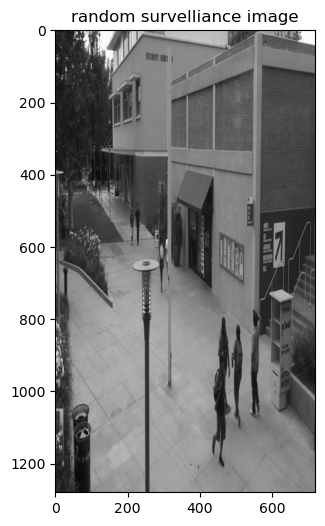

In [7]:
plt.figure(figsize=(6, 6))
plt.title('random survelliance image')
plt.imshow(np.reshape(video_mat[:,9], dims), cmap='gray')

the curves show motion in the image!


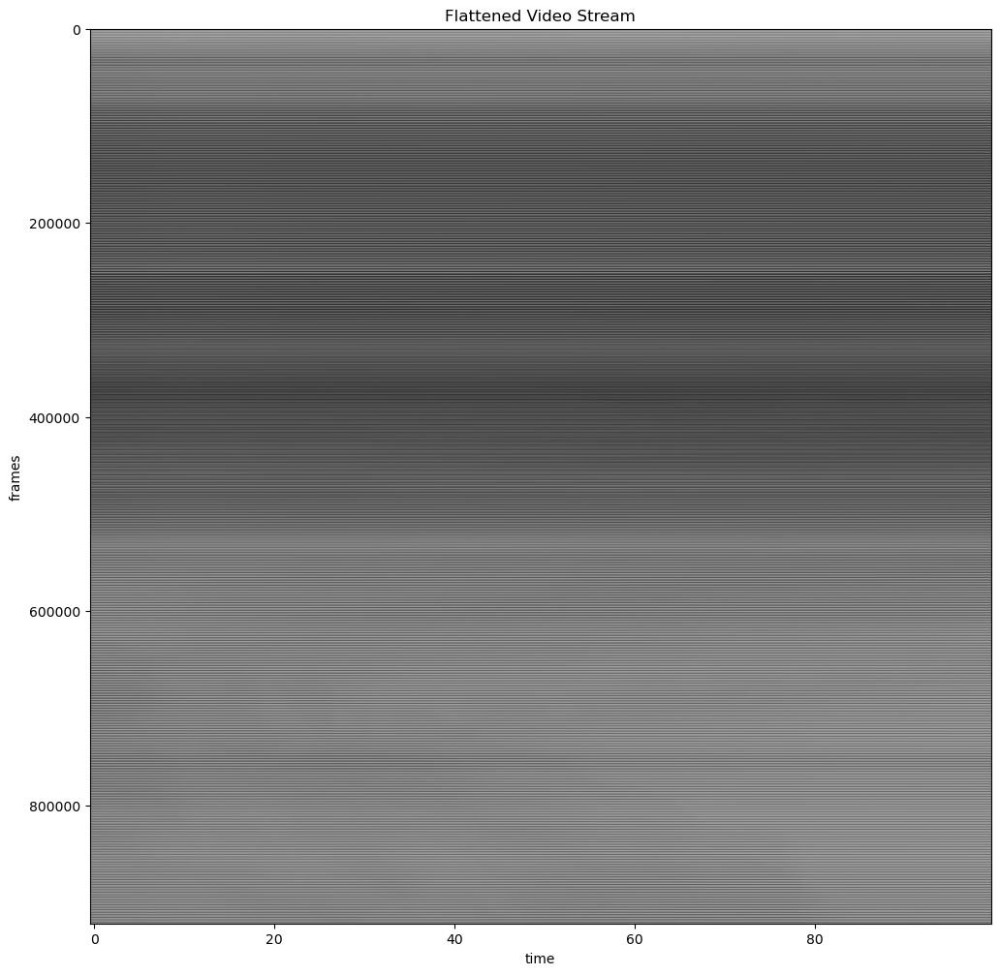

In [8]:
plt.figure(figsize=(12, 12))
plt.title('Flattened Video Stream')
plt.xlabel('time')
plt.ylabel('frames')
plt.imshow(video_mat, aspect='auto', cmap='gray')
print('the curves show motion in the image!')

#### The horizontal flat lines in the image above are made up of the identical pixel all the way across the video stream. The pixel that represents the motion of the humans is changed by the curves. Flat lines indicate lack of motion and minimal variation in mathematics. The motion can be seen as noise in a signal that is otherwise constant. So we should be able to extract the folks using noise filtering.

## Naive background removal
#### The array is sorted to produce the result shown below. To obtain a value that apparently has no motion, we can take the mode. This allows us to eliminate the backdrop.

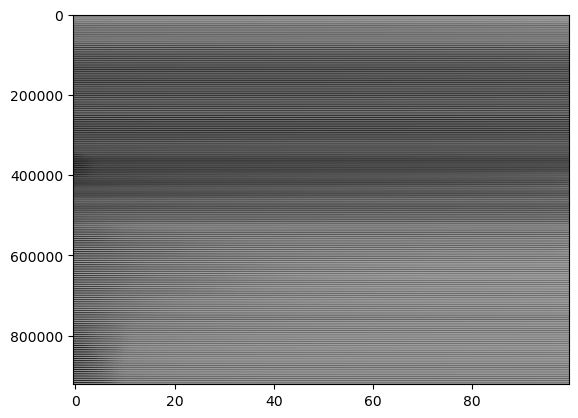

In [9]:
plt.imshow(np.sort(video_mat), aspect='auto', cmap='gray')


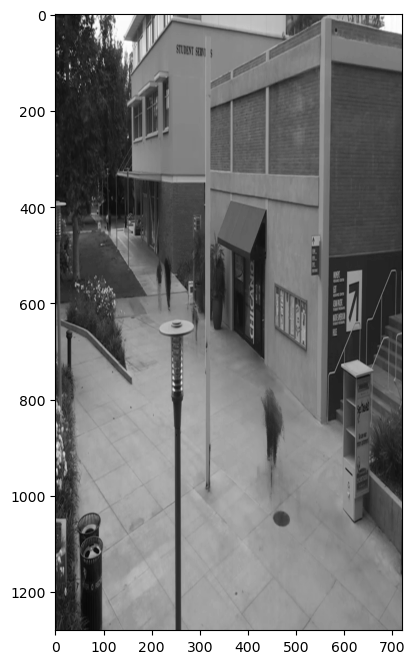

In [10]:
mode_col = int(video_mat.shape[1]/2)
sorted_mat = np.sort(video_mat)
background = sorted_mat[:, mode_col]

plt.figure(figsize=(8, 8))
plt.imshow(background.reshape(dims), cmap='gray')

In [11]:
people = video_mat - background.reshape(-1, 1)
people.shape

(921600, 100)

In [12]:
def plot_two_images(img1, img2, cmap='gray'): 
    
    plt.figure(figsize=(12, 7))
    plt.subplot(1, 2, 1);  plt.title("Original Image")
    plt.imshow(img1, cmap='gray')


    plt.subplot(1, 2, 2); plt.title("Background Removed")
    plt.imshow(img2, cmap='gray')
    plt.show()

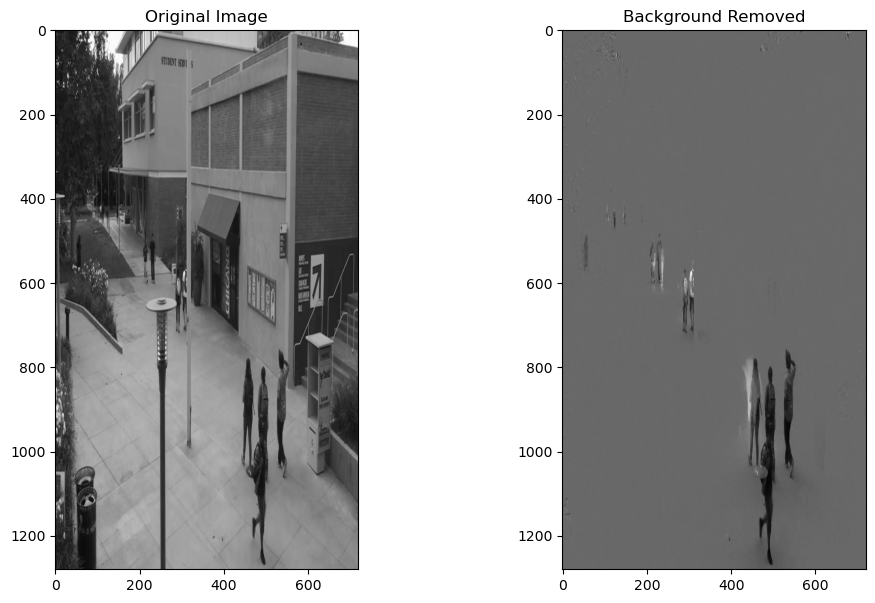

In [13]:
plot_two_images(video_mat[:,20].reshape(dims),
                people[:, 20].reshape(dims))

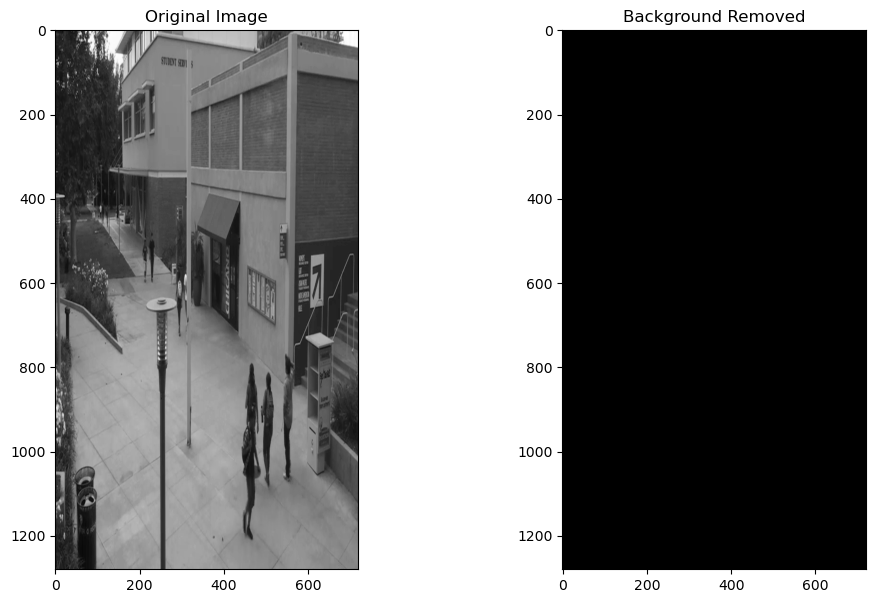

In [14]:
people[(people < 100) | (people > 200)] = 0
plot_two_images(video_mat[:,10].reshape(dims),
                people[:, 10].reshape(dims))

## Singular Value Decomposition
#### 

In [15]:
U, S, Vt = decomposition.randomized_svd(video_mat, 10)
print (U.shape, S.shape, Vt.shape)

(921600, 10) (10,) (10, 100)


In [16]:
low_rank = U @ np.diag(S) @ Vt
low_rank.shape


(921600, 100)

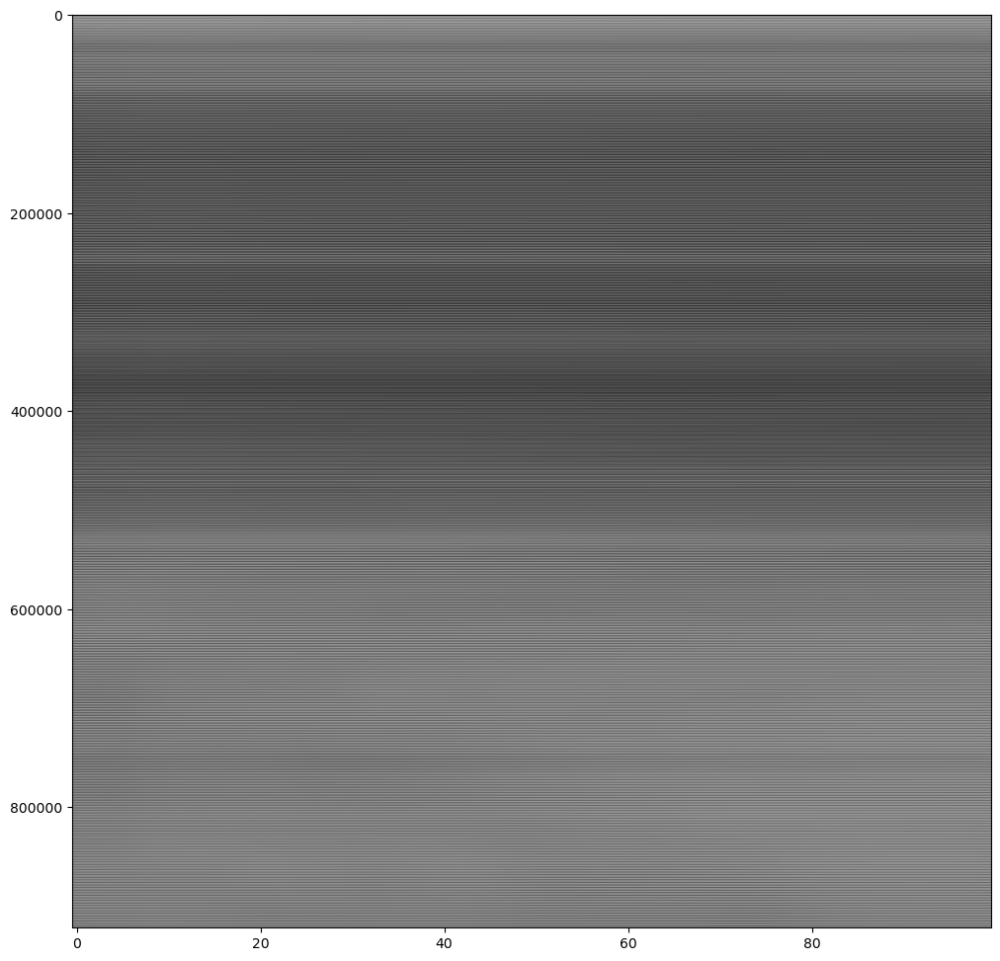

In [17]:
plt.figure(figsize=(12, 12))
plt.imshow(low_rank, aspect="auto", cmap='gray')

In [18]:
SVD_bg_removed = video_mat-low_rank

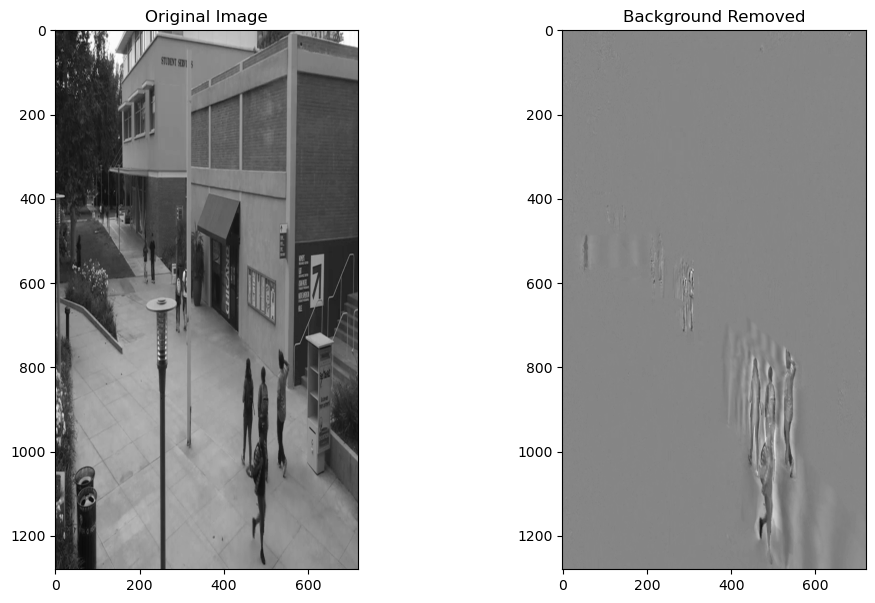

In [19]:
plot_two_images(video_mat[:,20].reshape(dims),
                SVD_bg_removed[:, 20].reshape(dims), cmap='gray')

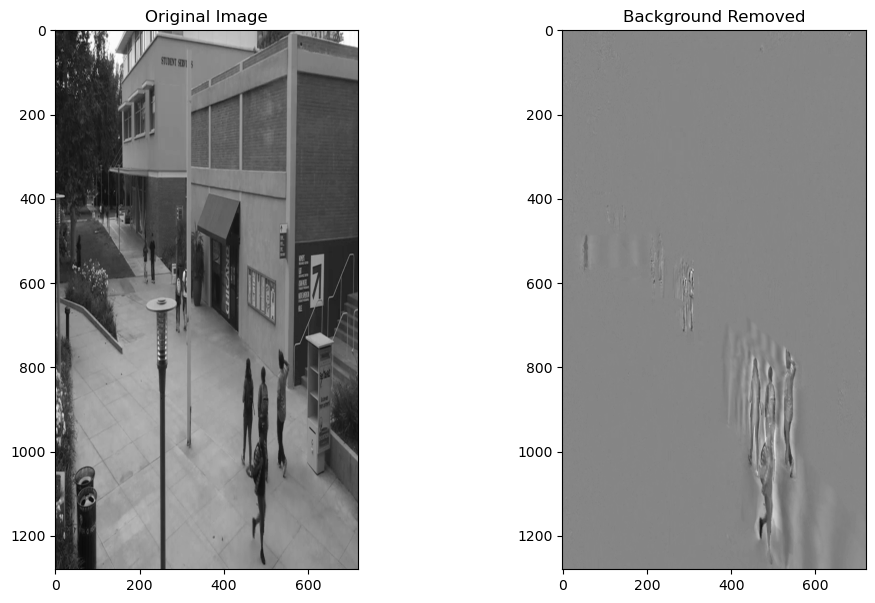

In [20]:
SVD_clipped = np.clip(SVD_bg_removed, None, 10)

plot_two_images(video_mat[:,20].reshape(dims),
                SVD_clipped[:, 20].reshape(dims), cmap='gray')

In [21]:
def SVD_background_removal(clip, frames=5, scale=1, n_components=2):
    #convert a video clip into a video tensor with SVD background removal 
    
    #format the output dimensions 
    shp = np.array(clip.get_frame(0).shape)
    shp[2] = -1
    
    #perform SVD
    A = video_to_matrix(clip, frames=frames, scale=scale)
    U, s, Vh = decomposition.randomized_svd(A, n_components)
    low_rank = U @ np.diag(s) @ Vh
    
    #remove background from input video tensor 
    bg_removed = A-low_rank
    bg_removed = bg_removed.reshape(shp)
    return bg_removed


In [22]:
bg = SVD_background_removal(video, frames=100)
bg.shape



(720, 1280, 100)

In [23]:
video_mat.shape

(921600, 100)

Moviepy - Building video ../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01_OUT.mp4.
Moviepy - Writing video ../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01_OUT.mp4



Moviepy - Done !
Moviepy - video ready ../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01_OUT.mp4


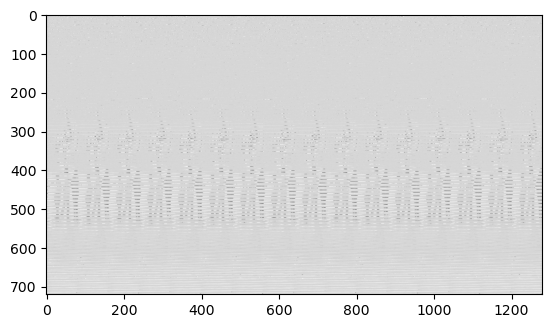

In [24]:

fps = video.fps
fig, ax = plt.subplots()
def make_frame(t):
    ax.clear()
    
    #processed frame 
    img = bg[:, : ,int(t*fps) % 100 ]
    
    #clip edges (noise)
    mean = np.mean(img)
    std = np.std(img)
    threshold = mean + 3 * std  # set the threshold to 3 standard deviations above the mean
    img = np.clip(img, None, threshold)
    
    #output 
    ax.imshow(img, cmap='gray')
    out = mplfig_to_npimage(fig)[:720, :1280, :100]
    out = Image.fromarray(np.uint8(out))
    #out = out.resize((1280, 720), Image.BICUBIC)
    out = np.array(out)
    return out 

#write to video 
animation = mpy.VideoClip(make_frame, duration=video.duration)
animation.write_videofile('../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01_OUT.mp4', fps=fps)

## Comparasion

In [25]:
video = mpy.VideoFileClip("../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01.avi")
#original surveillance video 
video.subclip(0,20).ipython_display(width=300)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [26]:
out = mpy.VideoFileClip("../IMAGE_PROC_PROJECT/Dataset_Stanford/videos/videosample01_OUT.mp4")
out.subclip(0,20).ipython_display(width=300)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


In [27]:
def make_video(matrix, dims, filename):
    mat_reshaped = np.reshape(matrix, (dims[0], dims[1], -1))
    
    fig, ax = plt.subplots()
    def make_frame(t):
        ax.clear()
        ax.imshow(mat_reshaped[...,int(t*fps %20)])
        return mplfig_to_npimage(fig)
    
    animation = mpy.VideoClip(make_frame, duration=int(10))
    animation.write_videofile(filename + '.mp4', fps=fps)

Moviepy - Building video moving_part.mp4.
Moviepy - Writing video moving_part.mp4



Moviepy - Done !
Moviepy - video ready moving_part.mp4


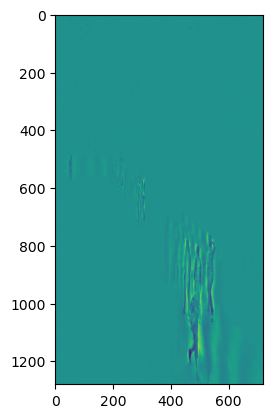

In [28]:
make_video(video_mat - low_rank, dims, "moving_part")

In [29]:
mpy.VideoFileClip("moving_part.mp4").subclip(0,10).ipython_display(width=300)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
